# _EDA z uwzględnieniem czynnika przestrzennego_

## Wczytanie odpowiednich pakietów potrzebnych do wykonania projektu

In [48]:
import streamlit as st
import pandas as pd
import geopandas as gpd
import numpy as np
import seaborn as sns
%matplotlib inline
import matplotlib.pyplot as pltl
import plotly.express as px
import plotly as plt
import plotly.graph_objects as go
import openpyxl
import folium
from shapely.geometry import Point, LineString, Polygon
import sweetviz as sv
import ipywidgets as widgets
from ipywidgets import interact, widgets
import folium
from folium.plugins import MarkerCluster
from IPython.display import display
import plotly.offline as pyo


## Przygotowanie danych
Dane dotyczące zanieczyszczeń powietrza pochodzące z WHO zawierają następujące zmienne:
- Measurement Year: Rok pomiaru.
- PM2.5 (μg/m3): Stężenie pyłów PM2.5 w mikrogramach na metr sześcienny.
- PM10 (μg/m3): Stężenie pyłów PM10 w mikrogramach na metr sześcienny.
- NO2 (μg/m3): Stężenie dwutlenku azotu (NO2) w mikrogramach na metr sześcienny.
- PM25 temporal coverage (%): Pokrycie czasowe danych dotyczących pyłów PM2.5 (%).
- PM10 temporal coverage (%): Pokrycie czasowe danych dotyczących pyłów PM10 (%).
- NO2 temporal coverage (%): Pokrycie czasowe danych dotyczących dwutlenku azotu (%).
- Reference: Odwołanie do źródła danych.
- Number and type of monitoring stations: Liczba i typ stacji monitorujących.
- Version of the database: Wersja bazy danych.
- Status: Status danych.
    
Danymi brakującymi wymaganymi do tworzenia analiz przestrzennych są dane lokalizacyjne poszczególnych punktów pomiarowych,
dlatego potrzebne jest ich wygenerowanie. 

Aby w sposób szybki i efektywny wygenerować dane, wykonana została operacja wybrania wszystkich miast z danych (wyszukanie unikalnych wartości dla państw i miast).
Tak przygotowane dane można było przekazać prosto do algorytmów generowania współrzędnych.

Narzędziami, które umożliwiły wygenerowanie wspołrzędnych miast dla których zmierzone zostały wartości zanieczyszczeń były:
- ArcGIS Pro -> narzędzie "Geocode Table", które umożliwiło w bardzo krótkim czasie wygenerowanie potrzebnych współrzędnych latitude i longitude (Y i X) (czas genreacji: kilkanaście sekund) 
- Geocode by Awesome Table, czyli rozszerzenie do arkuszy kalkulacyjnych Google umożliwiające generowanie współrzędnych 1000 punktów dziennie

Dla wszystkich miast oprócz 140 udało się przypisać współrzędne używając ArcGIS Pro, natomiast dla pozostałych lokalizacji do przypisania im koordynatów użyte zostało Geocode by Awesome Table.

Ostatecznie nie udało się przyporządkować punktów tylko jednej lokalizacji, stąd wiersze z tymi miastami zostaną usunięte na późniejszym etapie obóbki danych.

Po wygenerowaniu współrzędnych dla każdego miasta, zostały one dołączone do głównych danych za pomocą funkcji "add join" z ArcGIS Pro.

## Preprocessing danych
Gotowe dane zostały wczytane do jupyter notebook.

Usunięte zostały wyżej wspomniane wiersze bez lokalizacji (po dołączeniu do tabeli głównej były 2 takie wiersze).
Wyświetlone zostały również główne informacje o danych.

Następnie przy użyciu pakietu "sweetviz" wygenerowane zostały raporty opisujące poszczególne zmienne i ich wartości z zestawu danych.
Raport jest interaktywny, ukazuje takie informacje jak:
- opis zmiennych 
- ilość danych NA
- liczba wartości danej zmiennej
- wartości maksymalne, minimalne średnie itp.
- rozkład poszcególnych zmiennych 
- korelacje między zmiennymi



<class 'pandas.core.frame.DataFrame'>
Index: 32189 entries, 0 to 32190
Data columns (total 17 columns):
 #   Column                                  Non-Null Count  Dtype  
---  ------                                  --------------  -----  
 0   WHO Region                              32188 non-null  object 
 1   ISO3                                    32189 non-null  object 
 2   WHO Country Name                        32189 non-null  object 
 3   City or Locality                        32189 non-null  object 
 4   Measurement Year                        32189 non-null  int64  
 5   PM2.5 (μg/m3)                           15046 non-null  float64
 6   PM10 (μg/m3)                            21107 non-null  float64
 7   NO2 (μg/m3)                             22200 non-null  float64
 8   PM25 temporal coverage (%)              7273 non-null   float64
 9   PM10 temporal coverage (%)              5381 non-null   float64
 10  NO2 temporal coverage (%)               19890 non-null  float64

                                             |                                             | [  0%]   00:00 ->…


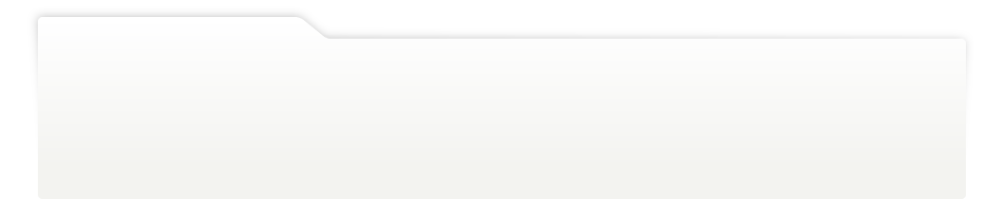
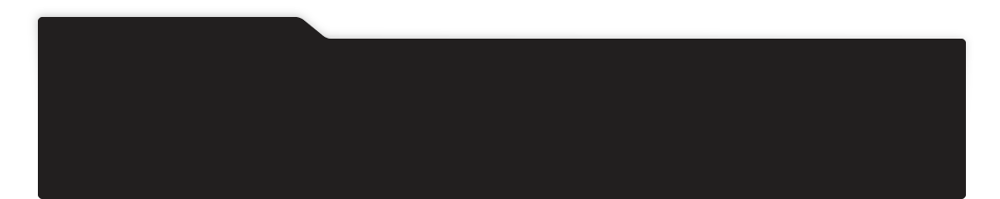
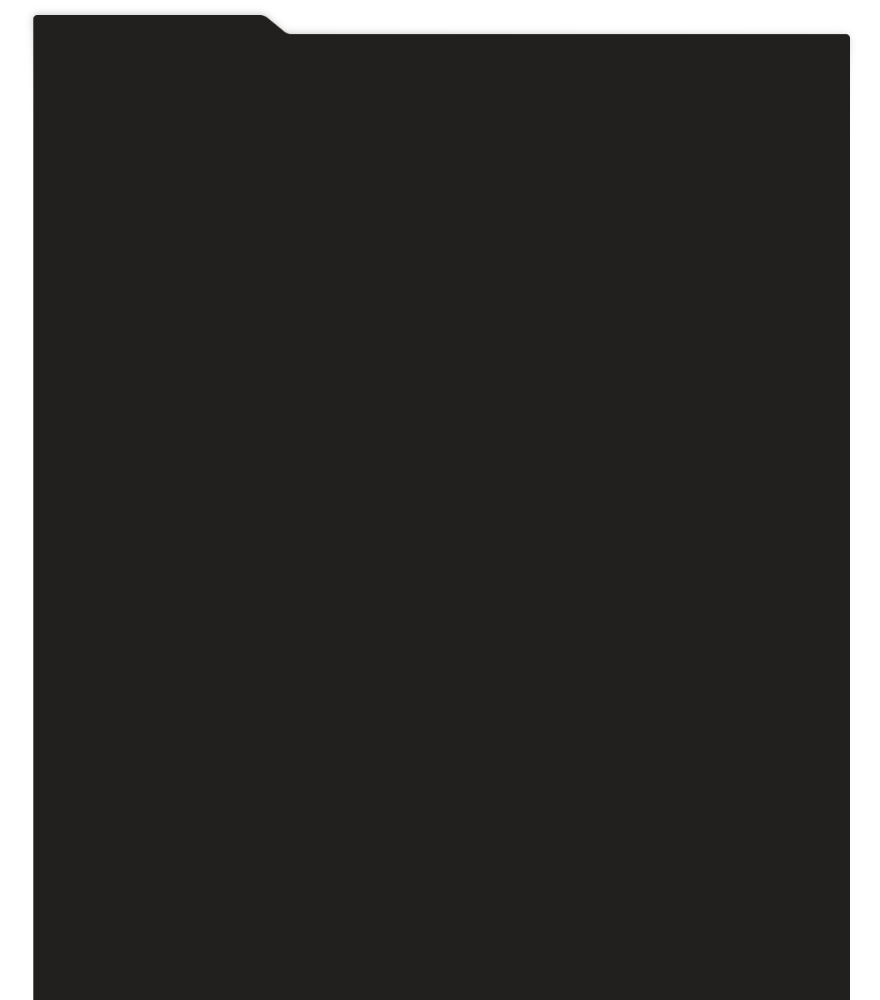
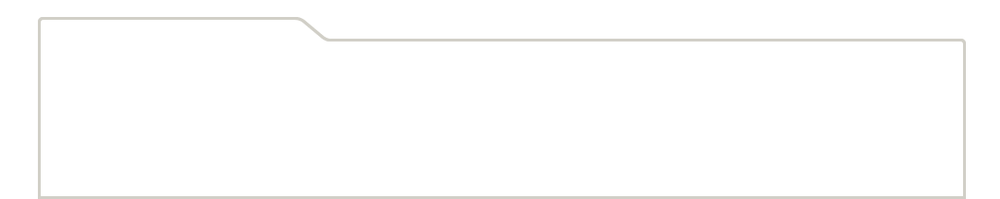
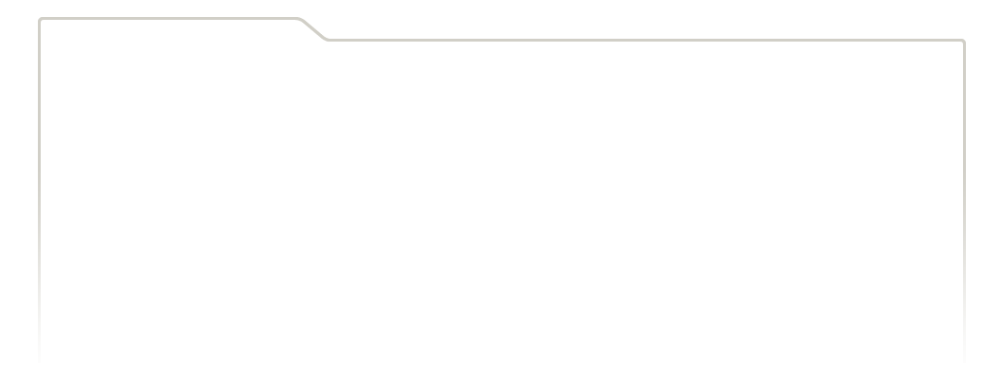
...
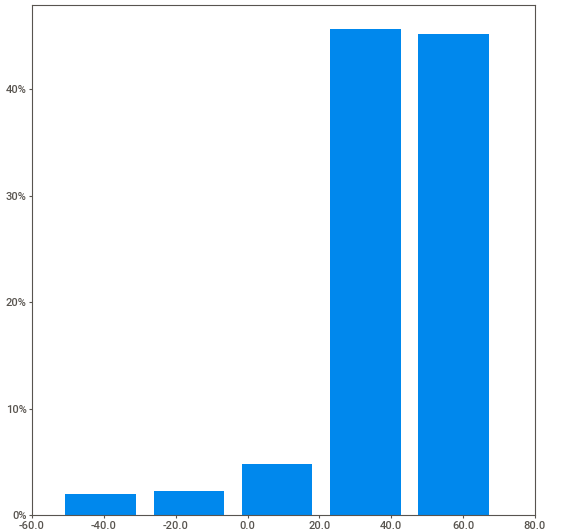
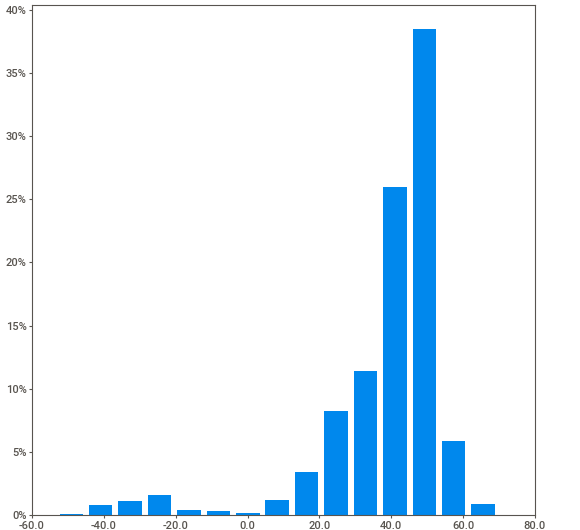
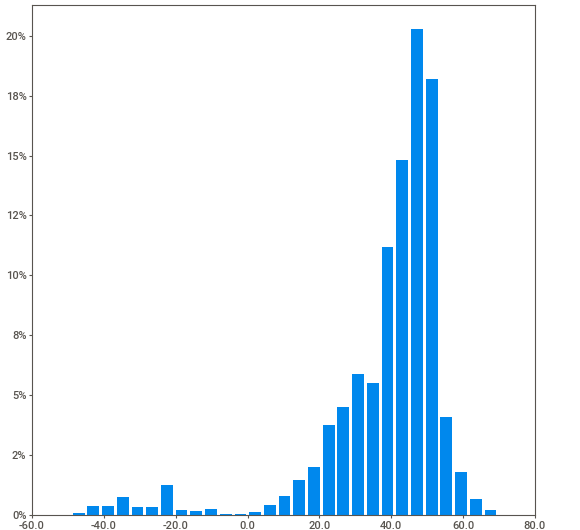
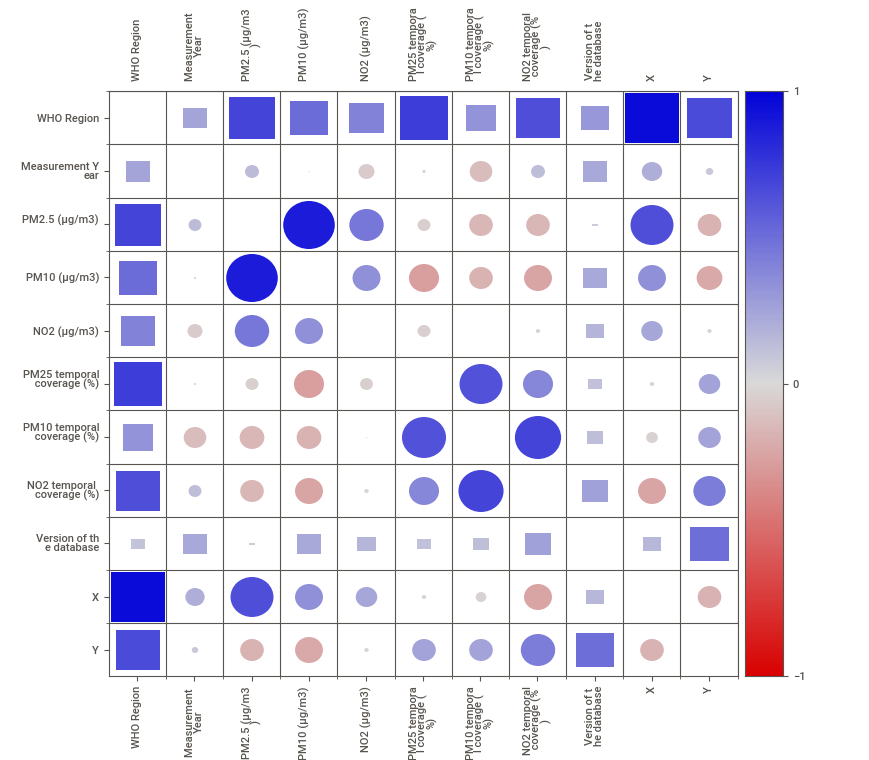
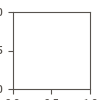

In [4]:
df = pd.read_excel('DANE_xlsx.xlsx')
df = df.dropna(subset=['X']) #usuwamymy dwa wiersze bez geometrii
df.info()
report = sv.analyze(df)
report.show_notebook()



Po obejrzeniu statystyk analizowanych danych podjęta została decyzja o usunięciu nieprzydatnych zmiennych do dalszych analiz.
Usnięte zostały zmienne:
- Reference
- Number and type of monitoring stations
- Version of the database
- Status

In [5]:
df.drop(columns=['Reference', 'Number and type of monitoring stations','Version of the database','Status'], inplace=True)
print(df.columns)

Index(['WHO Region', 'ISO3', 'WHO Country Name', 'City or Locality',
       'Measurement Year', 'PM2.5 (μg/m3)', 'PM10 (μg/m3)', 'NO2 (μg/m3)',
       'PM25 temporal coverage (%)', 'PM10 temporal coverage (%)',
       'NO2 temporal coverage (%)', 'X', 'Y'],
      dtype='object')


## Analiza danych 
W celu przeprowadzenia dokładniejszej analizy danych oraz porównania poszczególnych regionów, państw, czy miast oraz ich wartości stężeń pyłów zmierzonych w konkretnych lokalizacjach wykonano różnorodne wizualizacje danych.

### Wykres pudełkowy dla regionów świata

In [54]:
fig = px.box(df, x='WHO Region', y='PM2.5 (μg/m3)', title='Stężenie PM2.5 w różnych regionach')
fig.update_layout(xaxis_tickangle=0, xaxis=dict(title='Region', tickfont=dict(size=11)))  # Ustawienie kąta obrotu etykiet osi x i tytułu osi x
fig.update_layout(margin=dict(l=50, r=50, b=100, t=100))  # Dostosowanie marginesów
fig.show()

fig = px.box(df, x='WHO Region', y='PM10 (μg/m3)', title='Stężenie PM10 w różnych regionach')
fig.update_layout(xaxis_tickangle=0, xaxis=dict(title='Region', tickfont=dict(size=11)))  # Ustawienie kąta obrotu etykiet osi x i tytułu osi x
fig.update_layout(margin=dict(l=50, r=50, b=100, t=100))  # Dostosowanie marginesów
fig.show()

fig = px.box(df, x='WHO Region', y='NO2 (μg/m3)', title='Stężenie NO2 w różnych regionach')
fig.update_layout(xaxis_tickangle=0, xaxis=dict(title='Region', tickfont=dict(size=11)))  # Ustawienie kąta obrotu etykiet osi x i tytułu osi x
fig.update_layout(margin=dict(l=50, r=50, b=100, t=100))  # Dostosowanie marginesów
fig.show()


Na wykresie dostrzec można iż największe stężenia PM10 występują we wschodnich rejonach basenu Morza Śródzmienego (w skład tego regionu zaliczany jest także obszar tzw. Blsikiego Wschodu) oraz w Azji Południowo-Wschodniej.

Analziując PM2.5 dostrzegamy, iż rejon Wschodniego Pacyfiku i Azji Południowo-Wschodniej przodują jeśli chodzi o emisję zanieczyszceń do atmsofery.

Natomiast w przypadku NO2 ponownie region z najwyższymi odnotowanymi wartościami NO2 to obszar wschodniej części basenu Morza Śródziemnego i Bliskiego Wschodu .

Warto odnotować, iż w przypadku tych trzech rodzajów zawartości pyłów w powietrzu najniższe wartości najczęściej występują dla Europy oraz regionu obu Ameryk. Taki stan wynika najprawdopodobniej z faktu, iż w tych regionach występuja kraje wysoko rozwinięte, w których stosowane są działania mające na celu zmniejszenie emisji zanieczyszczeń spowodowane świadomością społeczeństwa o ochronie środowiska.
W regionach tych zlokalizowanych jest także wiele elektrowni korzystających ze źródeł energii odnawialnej.

### Interaktywny wykres średnich wartości zanieczyszceń w poszczególnych miastach.
Wykres ten umożliwia interaktywne przeglądanie ilości pyłów w  powietrzu dla poszczególnych miejscowości (pojedyńczych lub kilku jednoczeńie - zaznaczanie z klawiszem "ctrl")
oraz analizowanie wartości każdego z trzech rodzajów zanieczyszczeń.

In [7]:
def ave_poll_city(selected_cities, selected_pollutant):
    
    pollutant_column = ''
    if selected_pollutant == 'PM10':
        pollutant_column = 'PM10 (μg/m3)'
    elif selected_pollutant == 'PM2.5':
        pollutant_column = 'PM2.5 (μg/m3)'
    elif selected_pollutant == 'NO2':
        pollutant_column = 'NO2 (μg/m3)'
    else:
        print('Nie ma takiej zmiennej.')

    average_pollutant = []
    for city in selected_cities:
        city_data = df[df["City or Locality"] == city]
        avg_pollutant = city_data[pollutant_column].mean()
        average_pollutant.append(avg_pollutant)

    fig = go.Figure()
    fig.add_trace(go.Bar(x=selected_cities, y=average_pollutant, marker_color='skyblue'))
    fig.update_layout(title=f'Średnie stężenie {selected_pollutant} dla wybranych miast',
                      xaxis_title='Miasto', yaxis_title=f'Średnie {selected_pollutant} (μg/m3)')
    fig.show()

cities_sorted = sorted(df["City or Locality"].unique())
cities_widget = widgets.SelectMultiple(options=cities_sorted, description='Miasto:', layout={'width': 'max-content', 'height': '200px'})
pollutant_widget = widgets.Dropdown(options=['PM10', 'PM2.5', 'NO2'], description='Pył:')
widgets.interact(ave_poll_city, selected_cities=cities_widget, selected_pollutant=pollutant_widget)

interactive(children=(SelectMultiple(description='Miasto:', layout=Layout(height='200px', width='max-content')…

<function __main__.ave_poll_city(selected_cities, selected_pollutant)>

### Interaktywny wykres wartości zanieczyszczeń w danym mieście w zależności od roku

Wykres pozwala porównać między sobą zmierzone wartości zawartości pyłów w powietrzu w danym mieście w różnych latach.

In [8]:
cities = np.sort(df["City or Locality"].unique())

def year_poll_city(city, pollutant):
    city_data = df[df["City or Locality"] == city]
    city_data = city_data.dropna(subset=[pollutant, 'Measurement Year'])

    if city_data.empty:
        print(f'Brak danych dla miasta {city}.')
        return

    fig = px.bar(city_data, x='Measurement Year', y=pollutant, title=f'Średnie stężenie {pollutant} w {city} w poszczególnych latach',
                 color_discrete_sequence=px.colors.qualitative.Plotly)
    fig.update_xaxes(title='Rok', tickmode='linear')
    fig.update_yaxes(title=f'Średnie stężenie {pollutant}')
    fig.show()

city_widget = widgets.Dropdown(options=cities, description='Miasto:')
pollutant_widget = widgets.Dropdown(options=['PM10 (μg/m3)', 'PM2.5 (μg/m3)', 'NO2 (μg/m3)'], description='Pył:')
widgets.interact(year_poll_city, city=city_widget, pollutant=pollutant_widget)

interactive(children=(Dropdown(description='Miasto:', options=('A Coruna', 'Aachen', 'Aadorf', 'Aalborg', 'Aal…

<function __main__.year_poll_city(city, pollutant)>

### Interaktywny wykres średniego stężenia zanieczyszczeń pyłami na przestrzeni lat dla poszczególnych miast w danym państwie
Wykres pozwala na zobaczenie wartości średnich zanieczysczeń danym pyłem dla wsyzstkich miast w kraju.

In [37]:
countries = df["WHO Country Name"].unique()

def ave_poll_city_country(country, pollutant):
    country_data = df[df["WHO Country Name"] == country]
    country_data = country_data.dropna(subset=[pollutant, 'Measurement Year']) 

    if country_data.empty:
        print(f'Brak danych dla państwa {country}.')
        return

    grouped_data = country_data.groupby('City or Locality')[pollutant].mean().reset_index()
    fig = px.bar(grouped_data, x='City or Locality', y=pollutant, color='City or Locality')
    fig.update_layout(title=f'Średnie stężenie {pollutant} w różnych miastach {country}',
                      xaxis_title='Miasto', yaxis_title=f'Średnie stężenie {pollutant}',
                      showlegend=False)  # Usunięcie legendy
    fig.show()

country_widget = widgets.Dropdown(options=countries, description='Państwo:')
pollutant_widget = widgets.Dropdown(options=['PM10 (μg/m3)', 'PM2.5 (μg/m3)', 'NO2 (μg/m3)'],
                                    description='Pył:')
widgets.interact(ave_poll_city_country, country=country_widget, pollutant=pollutant_widget)

interactive(children=(Dropdown(description='Państwo:', options=('Afghanistan', 'Albania', 'Andorra', 'United A…

<function __main__.ave_poll_city_country(country, pollutant)>

### Podsumowanie wykresów 
Analiza wykresów pozwoliła zarówno na konkretne sprawdzenie danych, ale przede wszystkim umożliwiła w prosty sposób porównanie stężeń poszczególnych pyłów w powietrzu dla różnych lokalizacji.
Ważny wykresem odzwierciedlającym poziom pyłów w powietrzu okazał się wykres zawierający wykaz miast w poszczególnych państwach, gdzie można było zobaczyć np. jakie są poziomy zanieczyszczenia powietrza w stolicy, a jakie w innych miastach.
Natomiast wykres zanieczyszczeń dla poszczególnych lat w danym mieście pozwolił uwidocznić zmiany zawarotści pyłów w powietrzu na przestrzeni lat, przez co można sprawdzić czy w danym mieście dba się o powietrze, czy nie oraz czy monitoruje się jego stan (widać ile wartości NA i w których latach).

    

### Macierz korelacji
Obliczona została macierz korelacji między zmiennymi liczbowymi dotyczącymi pomiaru zanieczyszczeń.

Widoczna jest duża korelacja między zmeinnymi PM10 i PM2.5 wynoszącą aż 0.89.
Oznacza to, że zmiana jednej zmiennej np. wzrost PM10 powoduje także wzrost PM2.5 i odwrotnie.

Warto zwrócic uwagę także na korelacje między zmiennymi PM25 total coverage (Procentowy zasięg w danym roku, jako średnia procentowego zasięgu stacji) dla PM10 i PM2.5, gdyż korelacja między nimi też jest na dobrym poziomie 0.54.

Ciekawym faktem jest niska korelacja między PM10 i NO2 oraz PM2.5 i NO2. Wydawać by się mogło, iż np. wzrost stężenie NO2 może mieć powiązanie z wzrostem innych pyłów, jednak korelacja upewnia nas w tym , że jednak nie ma między nimy zbytniego powiązania.

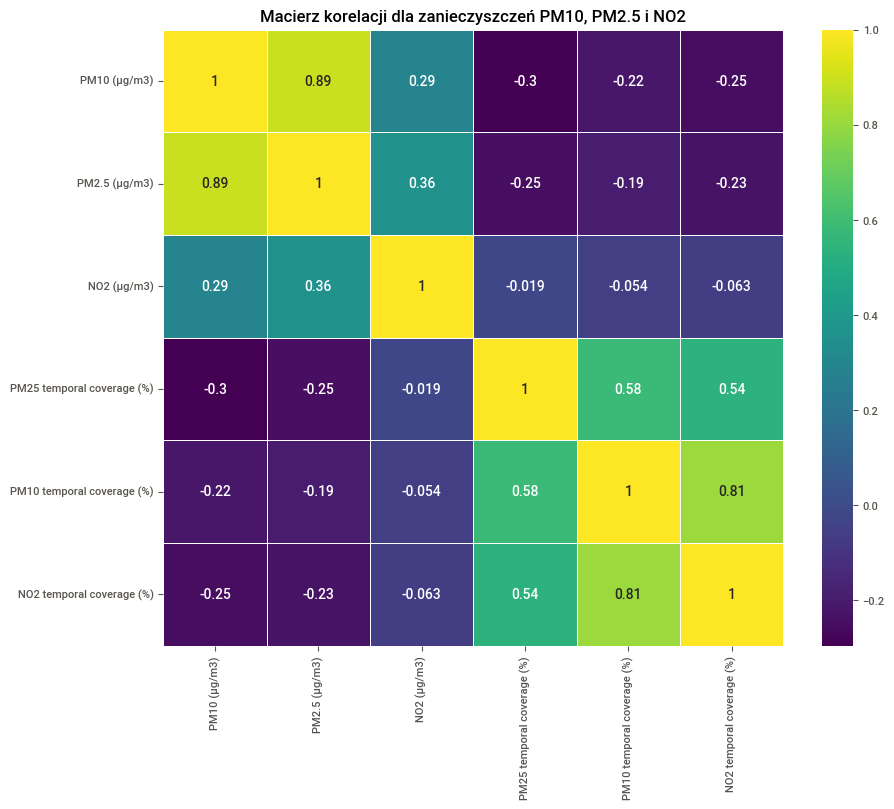

In [122]:
# kolumny z zanieczyszczeniami
pollutants = df[['PM10 (μg/m3)', 'PM2.5 (μg/m3)', 'NO2 (μg/m3)', 'PM25 temporal coverage (%)','PM10 temporal coverage (%)','NO2 temporal coverage (%)']]
pollutants = pollutants.dropna()
corr = pollutants.corr()

plt.figure(figsize=(10, 8))
sns.heatmap(corr, annot=True, cmap='viridis', linewidths=.5)
plt.title('Macierz korelacji dla zanieczyszczeń PM10, PM2.5 i NO2')
plt.show()

### Wykres korelacji z linią trendu

Aby sprawdzić jakiego rodzaju zależności zachodzą pomiędzy zmiennymi wykonany został wykres korealcji.

Warto zauważyć, że w przypadku korelacji zmiennych PM2.5 i PM10 linia trendu wskazuje na wyraźny trend liniowy.
Natomiast w przypadku korelacji zmiennych PM10 i PM2.5 ze zmienną NO2 ciężko jest odpowiedzieć na pytanie jakiego rodzaju zmienność występuje pomiędzy tymi zmiennymi, czy jest liniowa, czy nieliniowa, czy w ogóle da się to ustalić. W tym przypadku linia trendu jest ciężka do dopasowania.

In [20]:
# kolumny z zanieczyszczeniami
data = df[['PM10 (μg/m3)', 'PM2.5 (μg/m3)', 'NO2 (μg/m3)', 'PM25 temporal coverage (%)','PM10 temporal coverage (%)','NO2 temporal coverage (%)']]
data = data.dropna()

def plot_correlation_with_trend(feature_x, feature_y):
    pltl.figure(figsize=(8, 6))
    sns.scatterplot(data=data, x=feature_x, y=feature_y)
    slope, intercept = np.polyfit(data[feature_x], data[feature_y], 1)
    pltl.plot(data[feature_x], slope * data[feature_x] + intercept, color='red', linewidth=2)
    
    pltl.title(f'Wykres: {feature_x} vs {feature_y} z linią trendu')
    pltl.xlabel(feature_x)
    pltl.ylabel(feature_y)
    pltl.show()

features = list(data.columns)
interact(plot_correlation_with_trend, feature_x=features, feature_y=features)

interactive(children=(Dropdown(description='feature_x', options=('PM10 (μg/m3)', 'PM2.5 (μg/m3)', 'NO2 (μg/m3)…

<function __main__.plot_correlation_with_trend(feature_x, feature_y)>

## Uzupełnaianie wartości NA
Analizując i przeglądajac dane można zauważyć ogromną ilość wartości NA. Do wyestymowania brakujących wartości zdecydowano się na obliczenie średnich wartości dla każdej z 6 zmiennych dla każdego miasta, a następnie uzupełnienie nimi pozostałych wartości NA w danej lokalizacji. W przypadku gdy w danej lokalizacji dla wybranego parametru nie ma danych pomiarowych, wartości NA zostały pozostawione.
W ten sposób uzupełniona została duża część danych NA niwelując początkową duża liczbę braków danych.

Dlaczego nie zdecydowano się na inne metody? Wszystkie metody przewidywania wartości danych w konkretnie zlokalizowanych miejscach zazwyczaj wykorzystują metody liczenia odległości między lokalizacjami do estymowania wartości zmiennych jak np. meotda k najbliższych sąsiadów lub metoda krigingu,
gdzie dochodzą wagi poszczególnych punktów. Metody te mogą dać złe wyniki z uwagi na to, że dla wielu miejsc na świecie brakuje nam stanowisk pomiarowych np. Afryka i często mamy do czynienia z bardzo dużymi i nierównymi odległościami między punktami pomiarowymi, które
prowadziłyby do błędnego szacowania tych wartości traktując niektóre lokalizacje lepiej niż inne (np. Europa ma dużo punktów pomiarowych blisko siebie, Afryka mało i bardzo oddalone) dając mało wiarygodne wyniki.
Drugi, czynnikiem jest to iż w przypadku zanieczyszceznia powietrza, istnieje wiele innych czynników, które wpływają na ilość zanieczyszczeń np. liczba ludności w mieście, ukształtowanie terenu, suma opadów, czy ilość zakładów przemysłwych. Nie posiadając takich danych jesteśmy troche ograniczeni jeśli chodzi o możliwość używania bardziej zaawansowanych estymacji.

Przyjęte w projekcie metody liczenia wartości na podstawie danych z tej samej lokalziacji również nie jest idealna. Pozwala ona jednak na wyestymwoanie wartości zbliżonych do tych, które występowały na przestrzeni lat. Warto również zaznaczyć, że okres czasu z którego mamy pomiary nie jest okresem długim (dane dla około 10 lat dla państw z dużą ilością punktów pomiarowych) ,stąd te wartości nie będą się od siebie różnić w sposób znaczny. Inaczej mogło by być jeśli mielibyśmy dane np. z ubiegłego wieku, gdzie poszcególne wartości mogły by od siebie odbiegać diametralnie.

Dodatkowym plusem tej metody jest to, iż dla danych typu temporal coverage, często dla jednej lokalizacji w poszczególnych latach dane te mają takie same wartości np. 75 % więc liczenie średniej dla tych zmiennych nie zaburzy danych w znaczny sposób.

Ciekawym podejściem mogło by być zastąpienie NA wartością losowaną z przedziału od najmniejszej zmierzonej wartości do największej w danym miejscu pomiarowym. Jednak w przypadku występowania tylko jedengo pomiaru byłoby to niemożliwe do zrealziowania.

In [21]:

def NA_est(df):
    # Grupujemy dane według lokalizacji
    grouped_by_location = df.groupby('City or Locality')
    
    # Iterujemy przez grupy lokalizacji
    for location, location_data in grouped_by_location:
        # Średnia wartość PM2.5 dla danej lokalizacji
        mean_pm25 = location_data['PM2.5 (μg/m3)'].mean(skipna=True)
        mean_pm10 = location_data['PM10 (μg/m3)'].mean(skipna=True)
        mean_no2 = location_data['NO2 (μg/m3)'].mean(skipna=True)
        mean_pm25_temporal = location_data['PM25 temporal coverage (%)'].mean(skipna=True)
        mean_pm10_temporal = location_data['PM10 temporal coverage (%)'].mean(skipna=True)
        mean_no2_temporal = location_data['NO2 temporal coverage (%)'].mean(skipna=True)
        
        # Średnai tam gdzie braki
        df.loc[(df['City or Locality'] == location) & df['PM2.5 (μg/m3)'].isnull(), 'PM2.5 (μg/m3)'] = mean_pm25
        df.loc[(df['City or Locality'] == location) & df['PM10 (μg/m3)'].isnull(), 'PM10 (μg/m3)'] = mean_pm10
        df.loc[(df['City or Locality'] == location) & df['NO2 (μg/m3)'].isnull(), 'NO2 (μg/m3)'] = mean_no2
        df.loc[(df['City or Locality'] == location) & df['PM25 temporal coverage (%)'].isnull(), 'PM25 temporal coverage (%)'] = mean_pm25_temporal
        df.loc[(df['City or Locality'] == location) & df['PM10 temporal coverage (%)'].isnull(), 'PM10 temporal coverage (%)'] = mean_pm10_temporal
        df.loc[(df['City or Locality'] == location) & df['NO2 temporal coverage (%)'].isnull(), 'NO2 temporal coverage (%)'] = mean_no2_temporal
    
    return df

df = NA_est(df)

# Przykladowe sprawdzenie kilku rekordów
print(df[32180:32188])
#sprawdzenie pustych wartośći 
print(df.isnull().sum())

           WHO Region ISO3 WHO Country Name City or Locality  \
32182  African Region  ZAF     South Africa        Waterberg   
32183  African Region  ZAF     South Africa        Waterberg   
32184  African Region  ZAF     South Africa       West Coast   
32185  African Region  ZAF     South Africa       West Coast   
32186  African Region  ZAF     South Africa       West Coast   
32187  African Region  ZAF     South Africa       West Coast   
32188  African Region  ZAF     South Africa       West Coast   
32189  African Region  ZAF     South Africa       West Coast   

       Measurement Year  PM2.5 (μg/m3)  PM10 (μg/m3)  NO2 (μg/m3)  \
32182              2020         15.570         41.06         8.86   
32183              2021         18.860         44.71        18.37   
32184              2011          7.205         22.22        16.36   
32185              2014          7.205         23.98        10.67   
32186              2015          7.470         24.64         7.64   
32187    

Sprawdźmy raz jeszcze zestaw danych używając pakietu "sweetviz".

<class 'pandas.core.frame.DataFrame'>
Index: 32189 entries, 0 to 32190
Data columns (total 13 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   WHO Region                  32188 non-null  object 
 1   ISO3                        32189 non-null  object 
 2   WHO Country Name            32189 non-null  object 
 3   City or Locality            32189 non-null  object 
 4   Measurement Year            32189 non-null  int64  
 5   PM2.5 (μg/m3)               19001 non-null  float64
 6   PM10 (μg/m3)                24230 non-null  float64
 7   NO2 (μg/m3)                 24849 non-null  float64
 8   PM25 temporal coverage (%)  11605 non-null  float64
 9   PM10 temporal coverage (%)  16067 non-null  float64
 10  NO2 temporal coverage (%)   21991 non-null  float64
 11  X                           32189 non-null  float64
 12  Y                           32189 non-null  float64
dtypes: float64(8), int64(1), object(4)
m

                                             |                                             | [  0%]   00:00 ->…


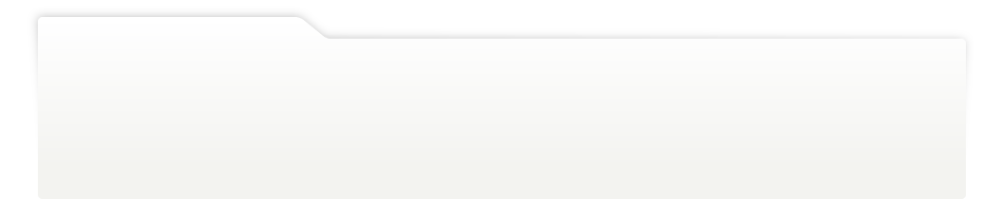
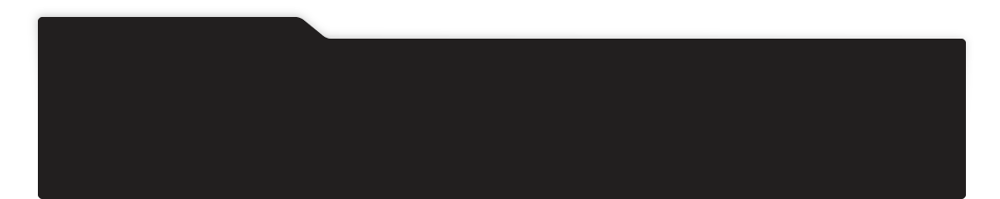
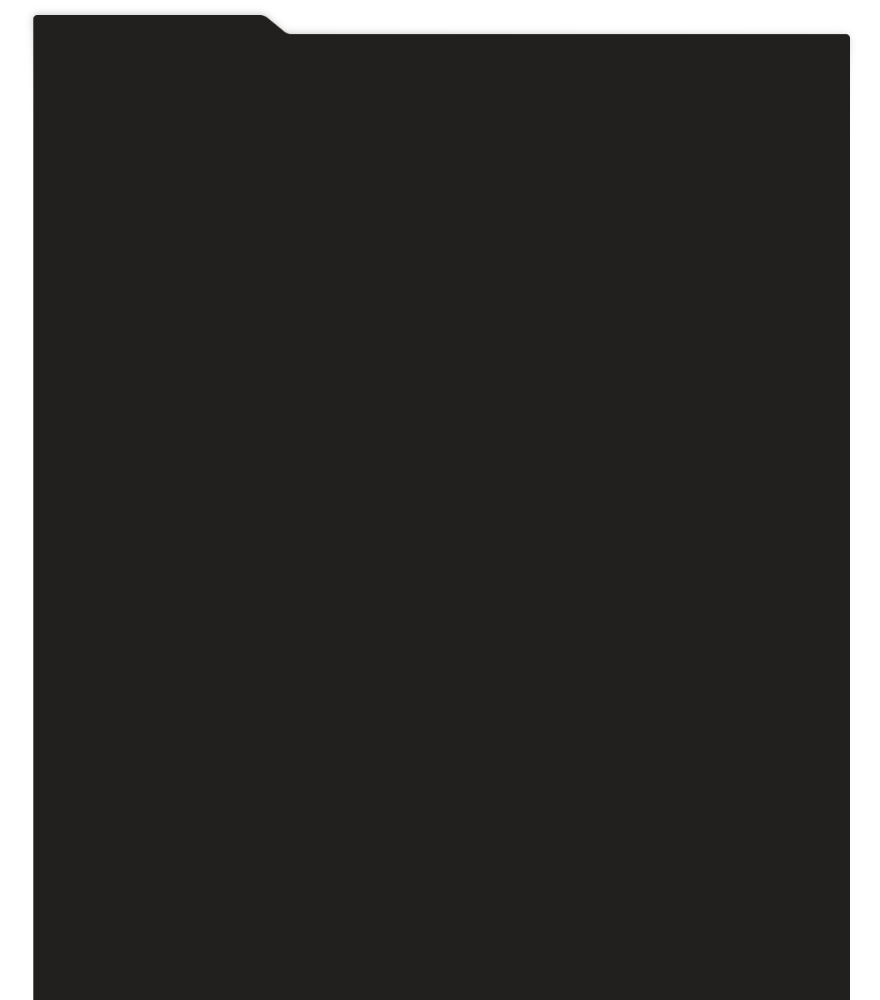
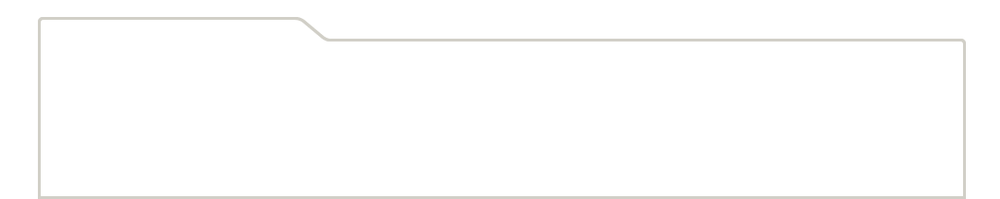
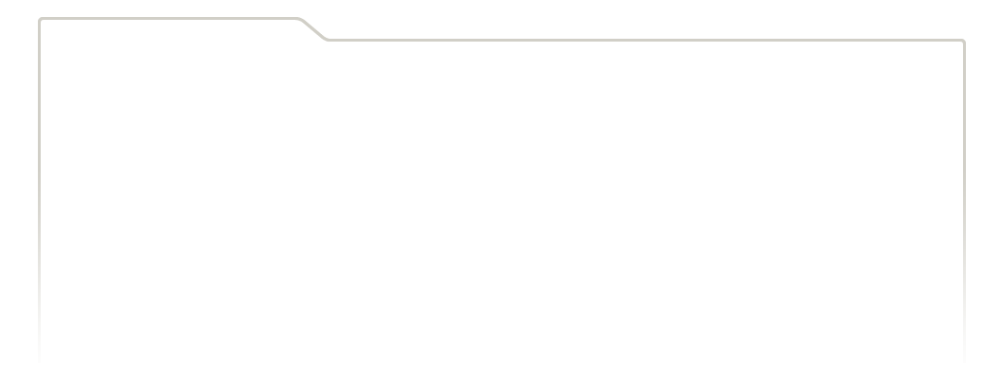
...
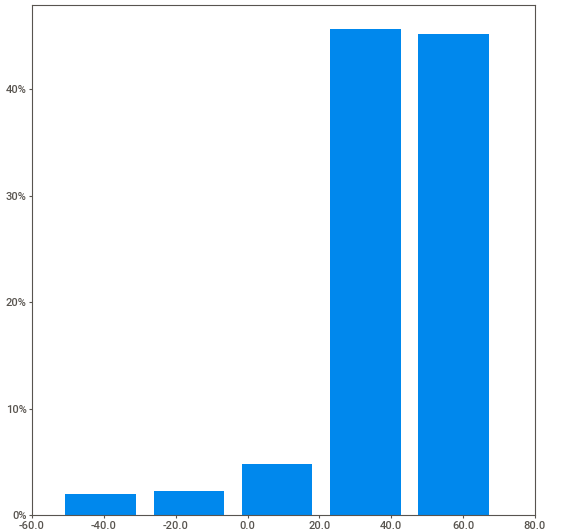
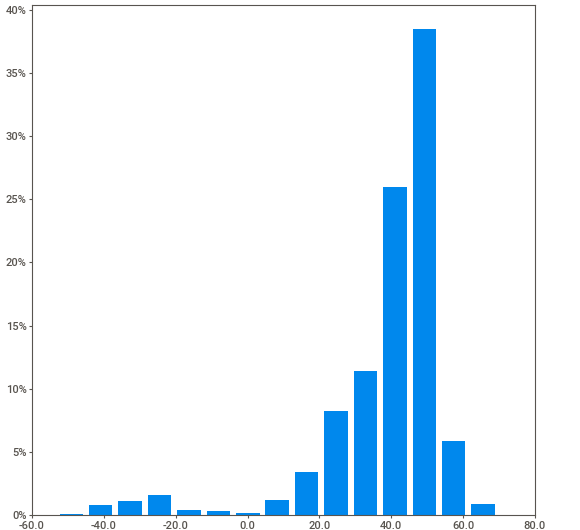
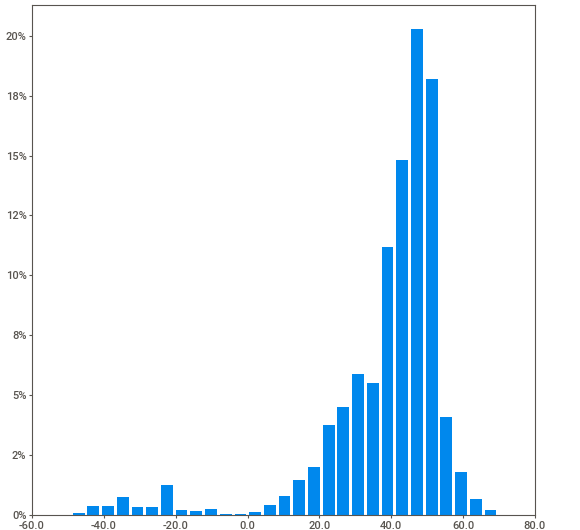
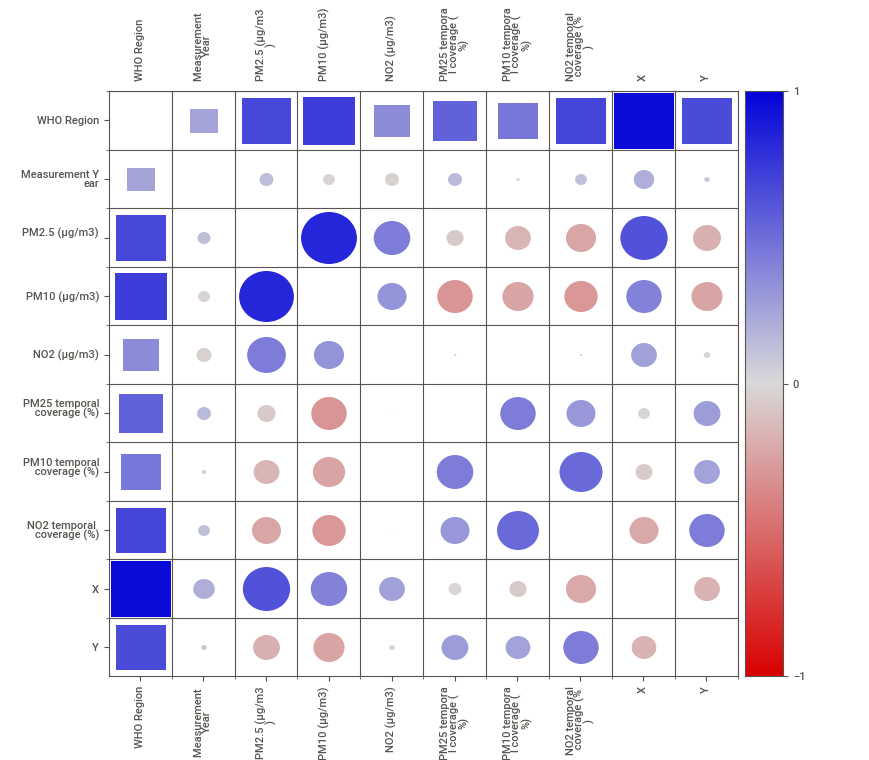
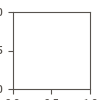

In [22]:
df.info()
report = sv.analyze(df)
report.show_notebook()

 Średnio zniwelowanych zostało kilka tysięcy braków danych dla każdej ze zmiennych dotyczących zanieczyszcenia powietrza pyłami zmniejszając liczbę braków od kilku do kilkudziesięciu procent np. PM2.5  z 53% do 41%,czy PM10 temporal coverage (%) z 83% do 50%

## Wyświetlanie mapy z lokalizacjami pomiarów
Każdą z miejscowości zlokalizowano na interaktywnej mapie i oznaczono za pomocą znacznika, po którego naciśnięciu wyświetla się pop-up z informacjami o ilości stężenia poszczególnych pyłów w powietrzu wraz z datą pomiaru.

In [23]:
import folium
from folium.plugins import MarkerCluster

# Grupowanie danych po lokalizacji
grouped_df = df.groupby(['X', 'Y'])

# mapa
m = folium.Map(location=[df['Y'].mean(), df['X'].mean()], zoom_start=5)

# Grupowanie markerów
marker_cluster = MarkerCluster().add_to(m)

for (x, y), group_data in grouped_df:
    popup_html = f"<div style='max-height: 200px; overflow-y: auto;'><h3>{group_data['City or Locality'].iloc[0]}</h3>"
    for idx, row in group_data.iterrows():
        pm25 = round(row['PM2.5 (μg/m3)'], 2)
        pm10 = round(row['PM10 (μg/m3)'], 2)
        no2 = round(row['NO2 (μg/m3)'], 2)
        pm25_coverage = round(row['PM25 temporal coverage (%)'], 2)
        pm10_coverage = round(row['PM10 temporal coverage (%)'], 2)
        no2_coverage = round(row['NO2 temporal coverage (%)'], 2)
        # Jak mam wygląać pop-up
        popup_html += f"""
            <b>Rok pomiarów:</b> {row['Measurement Year']}<br>
            <b>PM2.5:</b> {pm25}<br>
            <b>PM10:</b> {pm10}<br>
            <b>NO2:</b> {no2}<br>
            <b>PM2.5 temporal coverage (%):</b> {pm25_coverage}<br>
            <b>PM10 temporal coverage (%):</b> {pm10_coverage}<br>
            <b>NO2 temporal coverage (%):</b> {no2_coverage}<br><br>
        """
    popup_html += "</div>"

    # Dodanie markera na mape
    popup = folium.Popup(popup_html, max_width=300)
    folium.Marker(location=[y, x], popup=popup).add_to(marker_cluster)

# przycisk
folium.plugins.ScrollZoomToggler().add_to(m)
m


## Interaktywna mapa średnich wartości stężenia pyłów dla danego kraju
Mapa przedstawia średnie stężenia pyłów w danym kraju w danym roku. Rok pomiarów można zmieniać suwakiem w dolnej części mapy.

In [33]:
from ipywidgets import widgets

def cou_generate(pollutant):
    df_pollutant = df[['ISO3', 'WHO Country Name', 'Measurement Year', pollutant]]
    df_pollutant = df_pollutant.dropna(subset=[pollutant])
    # srednia
    df_pollutant_avg = df_pollutant.groupby(['ISO3', 'WHO Country Name', 'Measurement Year'])[pollutant].mean().reset_index()
    df_pollutant_avg = df_pollutant_avg[df_pollutant_avg['Measurement Year'] >= 2010]
    df_pollutant_avg = df_pollutant_avg.sort_values(by='Measurement Year')

    fig = px.choropleth(df_pollutant_avg, 
                        locations='ISO3',  
                        color=pollutant,  
                        hover_name='WHO Country Name',  
                        animation_frame='Measurement Year',  
                        color_continuous_scale='Viridis',  
                        title=f'Średnie stężenie {pollutant} w różnych krajach na świecie') 
    fig.show()

pollutant_widget = widgets.ToggleButtons(
    options=['PM10 (μg/m3)', 'PM2.5 (μg/m3)', 'NO2 (μg/m3)'],
    description='Zanieczyszczenie:',
    disabled=False,
    button_style='', 
    tooltips=['Pył zawieszony PM10', 'Pył zawieszony PM2.5', 'Dwutlenek azotu']
)

interact(cou_generate, pollutant=pollutant_widget);

interactive(children=(ToggleButtons(description='Zanieczyszczenie:', options=('PM10 (μg/m3)', 'PM2.5 (μg/m3)',…

Analizując mape nasuwają się konkretne wnioski. Mapa potwierdza wstępnie wyciągnięte wnioski iż w regionach Azji Południowo-Wschodniej oraz wschodniej części basenu Morza Śródziemnego oraz regionu Bliskiego Wschodu, dla prawie każdego roku stężenia PM10 w
państwach znajduących się w tym rejonie są największe. Państwa, które mają wysokie stężenia to np. Indie, Iran, Arabia Saudyjska, Mongolia, Irak, Chiny.
Wysokie stężenia notują też kraje Afrykańskie dla których posiadamy dane np. Senegal, czy Egipt

W przypadku dancyh PM2.5 również największe stężenia odnotowywane były w tych rejonach co dla PM10. Potwierdza to wcześniej obliczona korelacja tych rodzajów pyłów.

Takie same zjawisko następuje w przypadku pomiarów stężenia NO2. Wysokie wartości tych stężeń można zaobserwować również w 
krajach głównie Ameryki Środkowej w państwach takich jak Kostaryka czy Gwatemala oraz w Meksyku.

W krajach europejskich, Stanch Zjednoczocznych, Kanadzie oraz Australi stężenia pyłów w powietrzu są bardzo niskie co potwierdza kierowanie się polityką niskoemisyjną, korzystanie z odnawialnych źródeł enregii oraz jej oszczędzanie.

Natomiast w krajach biedniejszych, zwłaszcza na terenach poza miastami zanieczyszczenia produkowane są poprzez spalanie węgla oraz często śmieci w piecach, co powoduje wysoką emisje zanieczyszczeń.
Kraje takie jak Indie, czy Chiny posiadają ogromne ilości węgla, który regularnie używany jest do produkcji energii co sprawia, że m.in tam właśnie są wysokie zanieczyszczenia. 
Istnieje, także zależność iż czym większy jest kraj tym większe zanieczyszczenia występują w powietrzu (wyjątek np. USA  - kraj wysoko rozwinięty).

## Wykorzystanie danych w celach predykcji
Dane poddane analizie są danymi z dużym potencjałem. 
Analizując jednak tego rodzaju dane potrzeba szerszego spojrzennia, czyli należy wykorzystać większą ilość zmiennych aby analiza była bardziej wiarygodna i precyzyjna. 
Wykonując poszczególne analizy bardzo odczuwalny był brak dancyh dotyczący np. liczby ludności w danym miejscu, lub populacji danego kraju. 
Interesującym czynnikiem mogącym  mieć znaczenie byłaby niewątpliwie wysokosć miejscowości nad poziomem morza, ukształtowanie terenu czy warunki klimatyczne panujace w danym miejscu (temperautra, suma opadów, kierunek i prędkość wiatru itp.)
Posiadając takie dane można byłoby je wykorzystać do zrobienia naprawdę ciekawych modeli predykcyjnych dotyczących zanieczyszczenia powietrza dla kolejnych lat.
Zwłaszca, że dane dotyczące np. temperatury, prędkości wiatru są często łatwo dosepne poprzez API, a dane dotyczące wysokości nad poziomem morza i populacji można znaleźc na różnego rodzaju stronach rządowych kraju lub geoportalach konkretnych miast.
Warto zastanowić się nad wykorzystaniem generatywnej sztucznej intelignecji do uzupełnainia tych braków danych lub próby estymacji danych pomiarowych w rejonach gdzie one nie występują.


## Podsumowanie

Dane te umożliwiły pokazanie w ciekawy sposób jakie zanieczyszcenia występują w poszczególnych rejonach i miejscach świata.
Uzyskane wyniki, okazały się być przewidywalne jeśli chodzi o dzisiejszy stan powietrza na świecie spowodowany między innymi masową produkcją energi poprzez różnego rodzaju elektrownie np. węglowe, która jest konieczna do wyprodukowania ciepła lub prądu (której ilość zależna jest między innymi od liczby ludności mieszkającej w danym kraju),
ilością samochodów przemieszczających się na danym terenie, czy polityką klimatyczną konkretnych państw.

Konieczne wydaje się pozyskiwanie danych z terenów, dla których ich nie posiadamy, gdyż mogą one ukazywać rezultaty, których
na ten moment nie znamy oraz które są np. utajnianie przez państwa niedemokratyczne. Zbiór danych który posiadamy wydaje się zbyt mało kompletny i zbyt ubogi aby mógł posłużyć do bardziej poważnych analiz. Moim zdaniem, żeby przeprowadzić bardziej dokładne analizy potrzeba więcej danych dotyczących czynników wpływających na zanieczyszcenie powietrza. 
Projekt wskazuje na to iż ważnym aspektem w analizach jest konieczność posiadania
jak największej ilości dancyh dla danej lokalizacji cyklicznie dla każdego roku, gdyż w wielu miejscach dopiero od nie dawna zaczęto notować ilość stężenia pyłow lub istnieją braki dla niektórych lat.

Jeśli jednak chodzi o stworzenie prostych map pokazujących zanieczyszczenie w danym miejscu oraz możliwość sprawdzenia danych dotyczących zanieczyszceń w prosty porównawczy sposób wykorzystując różnego rodzaju grafiki to zbiór ten jest wystarczający.

Posiadając bardziej kompletne dane dotyczące stanu powiatrza miast lub państw oraz inne dane dotyczące ich charakterystyk takich jak położenie, czy ilość ludności, bardziej dokładne dane czsaowe (np. dane z miesiaca lub pory roku), to za pomocą metod uczenia maszynowego 
będzie możliwość uzyskania całkiem ciekawych modeli przewidujących zanieczyszczenie, identyfikowania czynników, które najbardziej na nie wpływają oraz analizowania i wykrywania trendów w danych w zależności np. od pory roku czy miesiąca wykorzystujących zarówno dane dotyczące zanieczyszczeń
,jak i dane klimatyczne, czy przyrodnicze wybranych miast.
